<a href="https://colab.research.google.com/github/boangri/uai-thesis-notebooks/blob/main/notebooks/Reinforce.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Reinforce

In [ ]:
# !pip install stable-baselines==2.5.1 box2d
!pip install box2d-py

     |████████████████████████████████| 450kB 5.9MB/s 


In [ ]:
!pip install pyvirtualdisplay 
!pip install xvfbwrapper 
!apt-get update 
!apt-get install xvfb

  Created wheel for xvfbwrapper: filename=xvfbwrapper-0.2.9-cp37-none-any.whl size=5009 sha256=af9de044d98f2e190535a40a56d18d75641232a2fd5441e03bb2bb923716aba8
  Stored in directory: /root/.cache/pip/wheels/10/f2/61/cacfaf84b352c223761ea8d19616e3b5ac5c27364da72863f0
Successfully built xvfbwrapper
Get:1 https://cloud.r-project.org/bin/linux/ubuntu bionic-cran40/ InRelease [3,626 B]
Ign:2 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64  InRelease
Get:3 http://security.ubuntu.com/ubuntu bionic-security InRelease [88.7 kB]
Ign:4 https://developer.download.nvidia.com/compute/machine-learning/repos/ubuntu1804/x86_64  InRelease
Get:5 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64  Release [697 B]
Hit:6 https://developer.download.nvidia.com/compute/machine-learning/repos/ubuntu1804/x86_64  Release
Get:7 http://ppa.launchpad.net/c2d4u.team/c2d4u4.0+/ubuntu bionic InRelease [15.9 kB]
Get:8 https://developer.download.nvidia.com/compute/cuda/r

In [ ]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import torch as T
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

In [ ]:
import glob 
import io 
import base64 
from IPython.display import HTML 
import time 
from IPython import display as ipythondisplay 
from pyvirtualdisplay import Display 
import gym
from gym import wrappers
from gym import logger as gymlogger 
from gym.wrappers import Monitor 
gymlogger.set_level(40)

## Classes & Functions

In [ ]:
class PolicyNetwork(nn.Module):
    def __init__(self, ALPHA, input_dims, fc1_dims, fc2_dims, n_actions, chkpt_dir, name):
        super().__init__()
        self.checkpoint_dir = chkpt_dir
        self.checkpoint_file = os.path.join(self.checkpoint_dir, name)
        self.input_dims = input_dims
        self.fc1_dims = fc1_dims
        self.fc2_dims = fc2_dims
        self.n_actions = n_actions
        self.fc1 = nn.Linear(*self.input_dims, self.fc1_dims)
        self.fc2 = nn.Linear(self.fc1_dims, self.fc2_dims)
        self.fc3 = nn.Linear(self.fc2_dims, self.n_actions)
        self.optimizer = optim.Adam(self.parameters(), lr=ALPHA)

        self.device = T.device('cuda:0' if T.cuda.is_available() else 'cpu')
        self.to(self.device)

    def forward(self, observation):
        state = T.Tensor(observation).to(self.device)
        x = F.relu(self.fc1(state))
        x = F.relu(self.fc2(x))
        x = self.fc3(x)
        return x

    def save_checkpoint(self):
        print('... saving checkpoint ...')
        T.save(self.state_dict(), self.checkpoint_file)

    def load_checkpoint(self):
        print('... loading checkpoint ...')
        self.load_state_dict(T.load(self.checkpoint_file))

In [ ]:
class PolicyGradientAgent(object):
    def __init__(self, policyNetwork, GAMMA=0.99):
        self.gamma = GAMMA
        self.reward_memory = []
        self.action_memory = []
        self.policy = policyNetwork

    def choose_action(self, observation):
        probabilities = F.softmax(self.policy.forward(observation), dim=-1)
        action_probs = T.distributions.Categorical(probabilities)
        action = action_probs.sample()
        log_probs = action_probs.log_prob(action)
        self.action_memory.append(log_probs)

        return action.item()

    def store_rewards(self,reward):
        self.reward_memory.append(reward)

    def learn(self):
        self.policy.optimizer.zero_grad()
        # Assumes only a single episode for reward_memory
        G = np.zeros_like(self.reward_memory, dtype=np.float64)
        # for t in range(len(self.reward_memory)):
        #     G_sum = 0
        #     discount = 1
        #     for k in range(t, len(self.reward_memory)):
        #         G_sum += self.reward_memory[k] * discount
        #         discount *= self.gamma
        #     G[t] = G_sum

        G_sum = 0.
        for t in range(len(G)-1, -1, -1):
            G_sum *= self.gamma
            G_sum += self.reward_memory[t] 
            G[t] = G_sum
        
        mean = np.mean(G)
        std = np.std(G) if np.std(G) > 0 else 1
        G = (G - mean) / std

        G = T.tensor(G, dtype=T.float).to(self.policy.device)

        loss = 0
        for g, logprob in zip(G, self.action_memory):
            loss += -g * logprob

        loss.backward()
        self.policy.optimizer.step()

        self.action_memory = []
        self.reward_memory = []
        
    def save_model(self):
        self.policy.save_checkpoint()
    
    def load_model(self):
        self.policy.load_checkpoint()

In [ ]:
def learn(env, agent, n_games, history_file, freq=10):
    scores = []
    for i in range(n_games):
        done = False
        observation = env.reset()
        score = 0
        steps = 0
        while not done:
            action = agent.choose_action(observation)
            observation_, reward, done, info = env.step(action)
            score += reward
            steps += 1
            observation = observation_
        scores.append(score)
        agent.learn()
        if (i + 1) % freq == 0:
            avg_score = np.mean(scores[-100:])
            print('episode ', i + 1, 'score %.1f avg score %.1f steps %d' % (score, avg_score, steps))
        with open(history_file,'a') as h:   
            h.write("%d,%.3f,%d\n" % (i + 1, score, steps)) 
    agent.save_model()

In [ ]:
def test(env, agent, episodes=100):
    total = 0.
    for ep in range(episodes):
        score = 0.
        obs = env.reset()
        done = False
        while not done:
            action = agent.choose_action(obs)
            obs, reward, done, _ = env.step(action)
            score += reward
        if (ep + 1) % 10 == 0:
            print("episode: %d Score: %1.f" % (ep+1, score))
        total += score
    print("Average score %.2f" % (total/episodes))

In [ ]:
def video(env, agent, seed=42):
    env.seed(seed)
    env = wrap_env(env)
    obs = env.reset()
    done = False
    score = 0.
    while not done:
        env.render()
        action = agent.choose_action(obs)
        obs, reward, done, _ = env.step(action)
        score += reward
    env.close()
    print("Score=%.2f" % score)
    show_video()

def show_video():
    display = Display(visible=0, size=(1400, 900))
    display.start()
    mp4list = glob.glob(os.path.join(dir, 'video/*.mp4'))
    if len(mp4list) > 0:
        mp4 = mp4list[0]
        video = io.open(mp4, 'r+b').read()
        encoded = base64.b64encode(video)
        ipythondisplay.display(HTML(data='''<video alt="test" autoplay 
                loop controls style="height: 400px;">
                <source src="data:video/mp4;base64,{0}" type="video/mp4" />
             </video>'''.format(encoded.decode('ascii'))))
    else: 
        print("Could not find video")
    
def wrap_env(env):
    env = Monitor(env, os.path.join(dir, 'video'), force=True)
    return env

In [ ]:
def plot_history(history_file):
    df = pd.read_csv(history_file, header=None, names=('episode', 'score', 'steps'))
    x = df.episode
    y = df.score
    y1 = np.zeros_like(y)
    for i in range(len(x)):
        y1[i] = np.mean(y[i-100:i])
    steps = df.steps
    plt.figure(figsize=(12,12))
    plt.subplot(2, 1, 1)
    plt.scatter(x, y, label='очки')
    plt.plot(x, y1, color='C1', label='среднее за 100')
    plt.ylabel('Очки')
    plt.xlabel('Эпизоды')
    plt.legend()
    plt.grid()
    plt.title(f'История обучения - {env_name} {algo}')
    plt.subplot(2, 1, 2)
    plt.scatter(x, steps, color='C2', label='steps')
    plt.ylabel('шагов на эпизод')
    plt.xlabel('Эпизоды')
    plt.legend()
    plt.grid()
    plt.title(f'История обучения - {env_name} {algo}')
    plt.show()

In [ ]:
algo='reinforce'
home_dir = os.path.join('/content/drive/MyDrive/Thesys', algo)

## LunarLander-v2

In [ ]:
env_name = 'LunarLander-v2'
dir = os.path.join(home_dir, env_name)
history_file = os.path.join(dir, 'history.csv')
!mkdir -p $dir 

In [ ]:
%%time
env = gym.make(env_name)
policyNetwork = PolicyNetwork(ALPHA=0.001, input_dims=env.observation_space.shape, fc1_dims=256, fc2_dims=256, n_actions=env.action_space.n, chkpt_dir=dir, name='model.pt')
agent = PolicyGradientAgent(policyNetwork, GAMMA=0.99)
scores = []
n_games = 500

learn(env, agent, n_games, history_file)


/usr/local/lib/python3.7/dist-packages/numpy/core/fromnumeric.py:3373: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/usr/local/lib/python3.7/dist-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/usr/local/lib/python3.7/dist-packages/numpy/core/_methods.py:234: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
/usr/local/lib/python3.7/dist-packages/numpy/core/_methods.py:195: RuntimeWarning: invalid value encountered in true_divide
  arrmean, rcount, out=arrmean, casting='unsafe', subok=False)
/usr/local/lib/python3.7/dist-packages/numpy/core/_methods.py:226: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


AttributeError: ignored

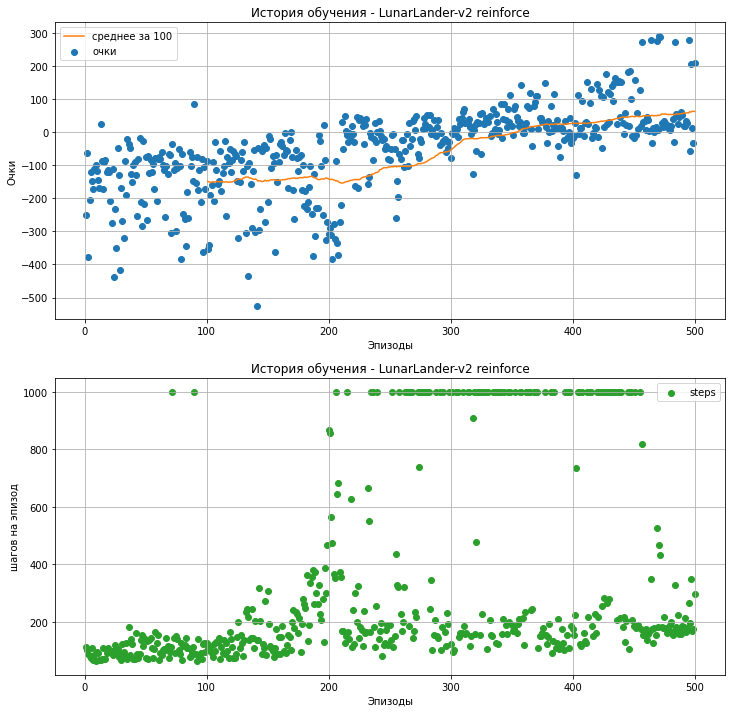

In [ ]:
plot_history(history_file)

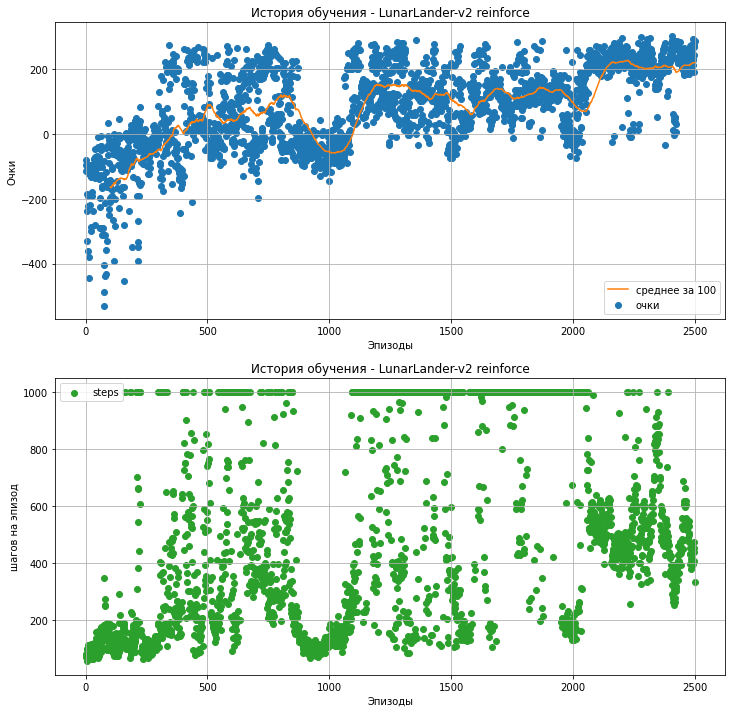

In [ ]:
plot_history(history_file)

In [ ]:
env = gym.make(env_name)
policyNetwork = PolicyNetwork(ALPHA=0.001, input_dims=env.observation_space.shape, fc1_dims=256, fc2_dims=256, n_actions=env.action_space.n, chkpt_dir=dir, name='model.pt')
agent = PolicyGradientAgent(policyNetwork, GAMMA=0.99)
agent.load_model()

... loading checkpoint ...


In [ ]:
%%time
env = gym.make(env_name)
test(env, agent, episodes=100)

episode: 10 Score: -31.4
episode: 20 Score: -48.7
episode: 30 Score: -70.5
episode: 40 Score: 283.3
episode: 50 Score: -28.9
episode: 60 Score: -23.3
episode: 70 Score: -15.1
episode: 80 Score: -0.1
episode: 90 Score: -62.0
episode: 100 Score: 10.3
Average score 16.16
CPU times: user 22.8 s, sys: 530 ms, total: 23.4 s
Wall time: 23.4 s


In [ ]:
env = gym.make(env_name)
video(env, agent, seed=42)

Score=-57.22


## CartPole-v1

In [ ]:
env_name = 'CartPole-v0'
dir = os.path.join(home_dir, env_name)
history_file = os.path.join(dir, 'history.csv')
!mkdir -p $dir 

In [ ]:
%%time
history_file = os.path.join(dir, 'history.csv')
env = gym.make(env_name)
policyNetwork = PolicyNetwork(ALPHA=0.001, input_dims=env.observation_space.shape, fc1_dims=256, fc2_dims=256, n_actions=env.action_space.n, chkpt_dir=dir, name='model.pt')
agent = PolicyGradientAgent(policyNetwork, GAMMA=0.9)
scores = []
num_episodes = 2000
for i in range(num_episodes):
    done = False
    score = 0
    observation = env.reset()
    steps = 0
    while not done:
        action = agent.choose_action(observation)
        observation_, reward, done, info = env.step(action)
        agent.store_rewards(reward)
        observation = observation_
        score += reward
        steps += 1
    scores.append(score)
    agent.learn()
    if (i + 1) % 100 == 0:
        avg_score = np.mean(scores[-100:])
        print('episode ', i + 1, 'score %.1f avg score %.1f steps %d' % (score, avg_score, steps))
    with open(history_file,'a') as h:   
        h.write("%d,%.3f,%d\n" % (i + 1, score, steps)) 
agent.save_model()

episode  100 score 50.0 avg score 56.4 steps 50
episode  200 score 122.0 avg score 145.0 steps 122
episode  300 score 200.0 avg score 169.2 steps 200
episode  400 score 200.0 avg score 111.2 steps 200
episode  500 score 173.0 avg score 195.5 steps 173
... saving checkpoint ...
CPU times: user 1min 25s, sys: 955 ms, total: 1min 26s
Wall time: 1min 27s


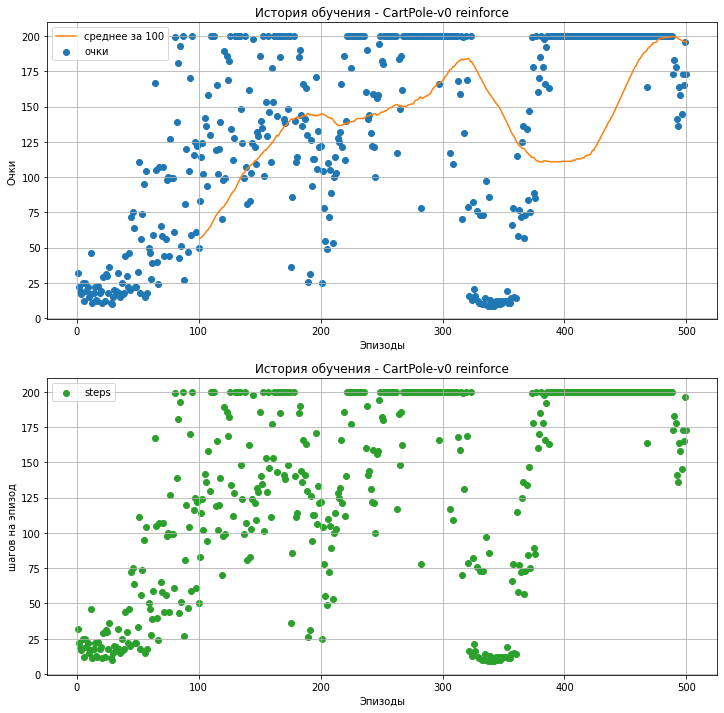

In [ ]:
plot_history(history_file)

In [ ]:
policyNetwork = PolicyNetwork(ALPHA=0.001, input_dims=env.observation_space.shape, fc1_dims=256, fc2_dims=256, n_actions=env.action_space.n, chkpt_dir=dir, name='model.pt')
agent = PolicyGradientAgent(policyNetwork, GAMMA=0.99)
agent.load_model()

... loading checkpoint ...


In [ ]:
%%time
env = gym.make(env_name)
episodes = 100
total = 0.
for ep in range(episodes):
    score = 0.
    obs = env.reset()
    done = False
    while not done:
        action = agent.choose_action(obs)
        obs, reward, done, _ = env.step(action)
        score += reward
    if (ep + 1) % 10 == 0:
        print("episode: %d Score: %1.f" % (ep+1, score))
    total += score
print("Average score %.2f" % (total/episodes))

episode: 10 Score: 200
episode: 20 Score: 195
episode: 30 Score: 197
episode: 40 Score: 200
episode: 50 Score: 200
episode: 60 Score: 200
episode: 70 Score: 200
episode: 80 Score: 184
episode: 90 Score: 200
episode: 100 Score: 200
Average score 196.81
CPU times: user 15.7 s, sys: 498 ms, total: 16.2 s
Wall time: 16.2 s


In [ ]:
env = gym.make(env_name)
env.seed(1)
env = wrap_env(env)
obs = env.reset()
done = False
score = 0.
while not done:
    env.render()
    action = agent.choose_action(obs)
    obs, reward, done, _ = env.step(action)
    score += reward
env.close()
print("Score=%.2f" % score)
show_video()

Score=200.00


## GrandPrix-v0

In [ ]:
!pip install gym_grand_prix

In [ ]:
import gym_grand_prix

env_name = 'GrandPrix-v0'
dir = os.path.join(home_dir, env_name)
history_file = os.path.join(dir, 'history.csv')
!mkdir -p $dir 

In [ ]:
possible_actions = ((0, 0), (1, .75), (-1, .75), (0, .75), (0, -.75))

In [ ]:
%%time

track = 3
n_rays = 5
env = gym.make(env_name)
options = {
    'nrays': n_rays,
    'seed': track, # задает номер трека
}
env.setOptions(options)
n_steps = 200
n_actions = 5
policyNetwork = PolicyNetwork(ALPHA=0.001, input_dims=env.observation_space.shape, fc1_dims=256, fc2_dims=256, n_actions=n_actions, chkpt_dir=dir, name='model.pt')
agent = PolicyGradientAgent(policyNetwork, GAMMA=0.99)
scores = []
num_episodes = 2500
for i in range(num_episodes):
    done = False
    score = 0
    observation = env.reset()
    steps = 0
    for step in range(n_steps):
        action = agent.choose_action(observation)
        observation_, reward, done, info = env.step(possible_actions[action])
        agent.store_rewards(reward)
        observation = observation_
        done = (step == (n_steps - 1))
        score += reward/n_steps
        steps += 1
    scores.append(score)
    agent.learn()
    if (i + 1) % 10 == 0:
        avg_score = np.mean(scores[-100:])
        print('episode ', i + 1, 'score %.3f avg score %.3f steps %d' % (score, avg_score, steps))
    with open(history_file,'a') as h:   
        h.write("%d,%.3f,%d\n" % (i + 1, score, steps)) 
agent.save_model()

pygame 2.0.1 (SDL 2.0.14, Python 3.7.10)
Hello from the pygame community. https://www.pygame.org/contribute.html
episode  10 score -0.738 avg score -1.134 steps 200
episode  20 score -0.656 avg score -1.174 steps 200
episode  30 score -0.493 avg score -1.153 steps 200
episode  40 score -0.880 avg score -1.112 steps 200
episode  50 score -1.001 avg score -1.027 steps 200
episode  60 score 0.408 avg score -1.017 steps 200
episode  70 score -1.692 avg score -1.024 steps 200
episode  80 score 0.247 avg score -1.050 steps 200
episode  90 score 0.461 avg score -1.045 steps 200
episode  100 score -1.757 avg score -1.060 steps 200
episode  110 score -0.172 avg score -1.026 steps 200
episode  120 score -0.971 avg score -0.973 steps 200
episode  130 score 0.684 avg score -0.936 steps 200
episode  140 score 2.974 avg score -0.765 steps 200
episode  150 score 1.625 avg score -0.621 steps 200
episode  160 score -0.504 avg score -0.297 steps 200
episode  170 score 1.698 avg score -0.067 steps 200
ep

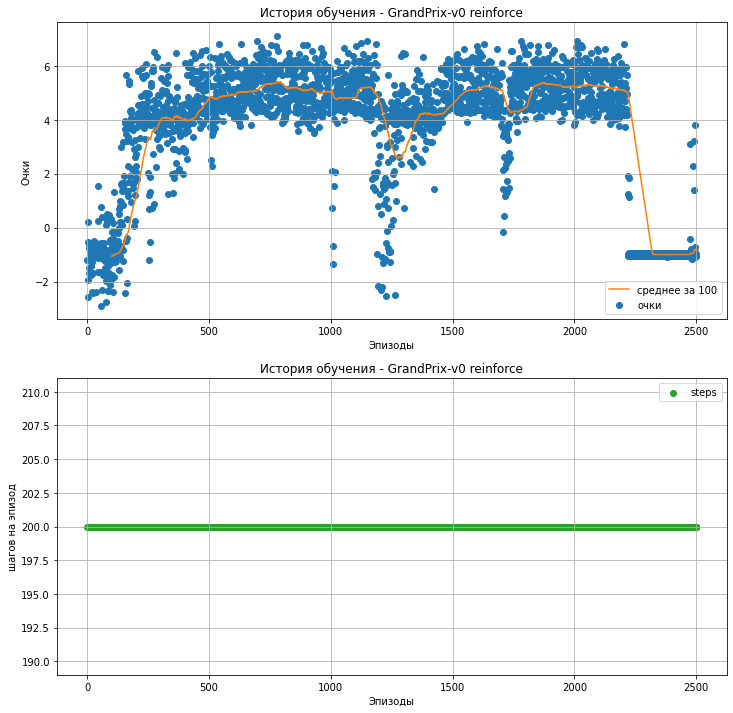

In [ ]:
plot_history(history_file)

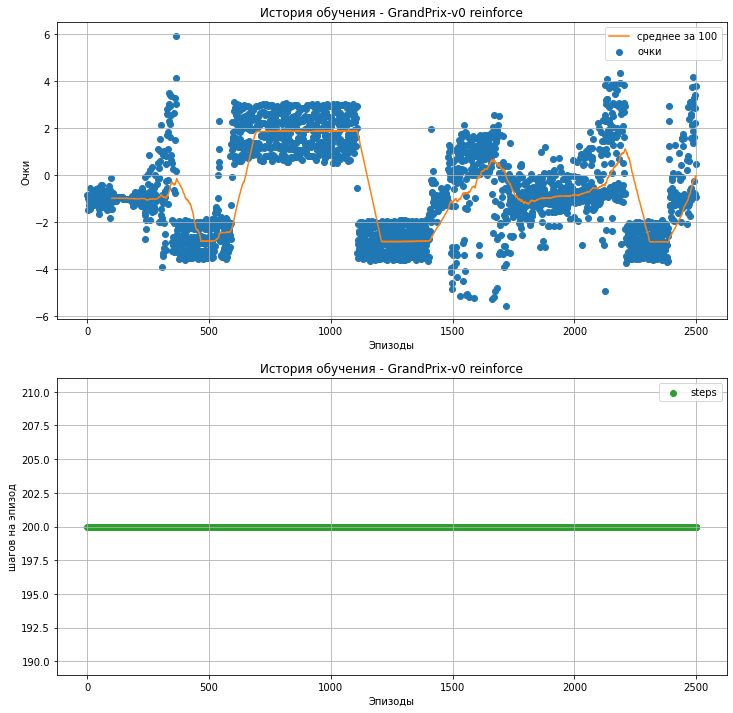

In [ ]:
plot_history(history_file)

In [ ]:
policyNetwork = PolicyNetwork(ALPHA=0.001, input_dims=env.observation_space.shape, fc1_dims=256, fc2_dims=256, n_actions=n_actions, chkpt_dir=dir, name='model.pt')
agent = PolicyGradientAgent(policyNetwork, GAMMA=0.99)
agent.load_model()

In [ ]:
%%time

env = gym.make(env_name)
options = {
    'nrays': n_rays,
    'seed': track, # задает номер трека
}
env.setOptions(options)
n_steps = 200
episodes = 100
total = 0.
for ep in range(episodes):
    score = 0.
    obs = env.reset()
    done = False
    for step in range(n_steps):
        action = agent.choose_action(obs)
        obs, reward, done, _ = env.step(possible_actions[action])
        score += reward/n_steps
    if (ep + 1) % 10 == 0:
        print("episode: %d Score: %.3f" % (ep+1, score))
    total += score
print("Average score %.3f" % (total/episodes))

episode: 10 Score: -0.985
episode: 20 Score: -0.985
episode: 30 Score: -0.985
episode: 40 Score: -0.985
episode: 50 Score: -0.985
episode: 60 Score: -0.985
episode: 70 Score: -0.985
episode: 80 Score: -0.985
episode: 90 Score: -0.985
episode: 100 Score: -0.985
Average score -1.000
CPU times: user 1min 52s, sys: 564 ms, total: 1min 53s
Wall time: 1min 53s


In [ ]:

env = gym.make(env_name)
options = {
    'nrays': n_rays,
    'seed': track, # задает номер трека
    'display': 1
}
env.setOptions(options)
env = wrap_env(env)
episodes = 10
env = wrap_env(env)
obs = env.reset()
for ep in range(episodes):
    score = 0.
    for step in range(n_steps):
        env.render()
        action = agent.choose_action(obs)
        obs, reward, done, _ = env.step(possible_actions[action])
        score += reward
env.close()
print("Score=%.3f" % score)
show_video()

Score=-196.952


#End

In [ ]:
import tensorflow as tf
import datetime, os
import numpy as np

%load_ext tensorboard

In [ ]:
path = '/tmp/mylogs/eager/'

current_time = datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
loss_log_dir = path + current_time + '/data'
writer = tf.summary.create_file_writer(loss_log_dir)

In [ ]:
x = np.linspace(0, 10., 101)
y = np.sin(x)
y1 = np.cos(2*x)
with writer.as_default():
    for epoch in range(101):
        tf.summary.scalar("sine", y[epoch], step=epoch)
        tf.summary.scalar("cosine", y1[epoch], step=epoch)
        writer.flush()

In [ ]:
%tensorboard --logdir '/tmp/mylogs/eager/'

Reusing TensorBoard on port 6006 (pid 227), started 0:01:54 ago. (Use '!kill 227' to kill it.)

<IPython.core.display.Javascript object>